In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BatchedGraphTemporalFourierLayer(nn.Module):
    def __init__(self, in_channels, out_channels, num_modes_space=16, num_modes_time=4, k_neighbors=8, scaling=True):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.num_modes_space = num_modes_space
        self.num_modes_time = num_modes_time
        self.k = k_neighbors

        if scaling:
            self.scale = 1 / (in_channels * out_channels)
        else:
            self.scale = 1

        self.weights = nn.Parameter(
            self.scale * torch.rand(
                in_channels, out_channels,
                num_modes_space, num_modes_time,
                dtype=torch.cfloat
            )
        )

    def fps(self, x):
        """
        Farthest Point Sampling for basis centers
        x: [batch_size, feat_dim, n_points, time_steps]
        """
        batch_size, feat_dim, n_points, _ = x.shape
        
        # Use first timestep points: [batch_size, n_points, feat_dim]
        points = x[..., 0].transpose(1, 2)
        
        # Initialize arrays for FPS
        centers_idx = torch.zeros(batch_size, self.num_modes_space, dtype=torch.long, device=x.device)
        distances = torch.ones(batch_size, n_points, device=x.device) * 1e10
        
        # Randomly select first center
        centers_idx[:, 0] = torch.randint(0, n_points, (batch_size,), device=x.device)
        
        # Iteratively select farthest points
        for i in range(1, self.num_modes_space):
            # Get previously selected center
            last_center = points[torch.arange(batch_size), centers_idx[:, i-1], :]
            last_center = last_center.view(batch_size, 1, feat_dim)
            
            # Compute distances to last center
            dist = torch.sum((points - last_center) ** 2, dim=-1)
            distances = torch.min(distances, dist)
            
            # Select farthest point
            centers_idx[:, i] = torch.max(distances, dim=-1)[1]
            
        return centers_idx

    def get_spatial_basis(self, x):
        batch_size, feat_dim, n_points, _ = x.shape
        
        # Get centers using FPS
        centers_idx = self.fps(x)  # [batch_size, num_modes_space]
        centers = x[..., centers_idx, 0]  # Get center points
        
        # Compute distances between all points and centers
        x_flat = x[..., 0].transpose(1, 2)  # [batch_size, n_points, feat_dim]
        centers_flat = torch.gather(
            x_flat, 
            1, 
            centers_idx.unsqueeze(-1).expand(-1, -1, feat_dim)
        )  # [batch_size, num_modes_space, feat_dim]
        
        D = torch.cdist(x_flat, centers_flat)
        
        # Compute RBF basis
        sigma = D.mean(dim=1, keepdim=True)
        basis = torch.exp(-D**2 / (2 * sigma**2))
        
        # Orthogonalize basis using QR
        Q = torch.linalg.qr(basis)[0]
        
        return Q.to(torch.float)


    def compl_mul2d(self, input, weights):
        return torch.einsum("bixt,ioxt->boxt", input, weights)

    def forward(self, x):
        batchsize = x.shape[0]

        # Get spatial basis (real-valued)
        basis = self.get_spatial_basis(x)  # [batch, points, modes]

        # Spatial transform (keeping real)
        x_ft_space = torch.einsum('bnk,bcnt->bckt', basis, x)

        # Temporal transform
        x_ft = torch.fft.rfft(x_ft_space, dim=-1)

        # Initialize output
        out_ft = torch.zeros(
            batchsize, self.out_channels,
            self.num_modes_space, x_ft.size(-1),
            dtype=torch.cfloat, device=x_ft.device
        )

        # Spectral convolution
        out_ft[..., :self.num_modes_time] = \
            self.compl_mul2d(
                x_ft[..., :self.num_modes_time],
                self.weights
            )

        # Inverse temporal transform
        out_space = torch.fft.irfft(out_ft, n=x.size(-1), dim=-1)

        # Inverse spatial transform (keeping real)
        out = torch.einsum('bnk,bckt->bcnt', basis, out_space.real)

        return out


class GFNO(nn.Module):
    def __init__(self, T_in, T_out, modes_space, modes_time, width, num_features, num_parameters):
        super(GFNO, self).__init__()
        self.modes_space = modes_space
        self.modes_time = modes_time
        self.width = width
        self.T_in = T_in
        self.T_out = T_out
        self.num_features = num_features
        self.num_parameters = num_parameters

        self.p = nn.Linear(T_in*num_features + num_parameters + 3, width)

        self.fourier0 = BatchedGraphTemporalFourierLayer(width, width, modes_space, modes_time)
        self.fourier1 = BatchedGraphTemporalFourierLayer(width, width, modes_space, modes_time)
        self.fourier2 = BatchedGraphTemporalFourierLayer(width, width, modes_space, modes_time)
        self.fourier3 = BatchedGraphTemporalFourierLayer(width, width, modes_space, modes_time)

        self.w0 = nn.Conv2d(width, width, 1)
        self.w1 = nn.Conv2d(width, width, 1)
        self.w2 = nn.Conv2d(width, width, 1)
        self.w3 = nn.Conv2d(width, width, 1)

        
        self.q = nn.Sequential(
            nn.Linear(width, 128),
            nn.LayerNorm(128),
            nn.GELU(),
            nn.Linear(128, num_features)
        )


    def get_t_span(self, t_in, t_out, batch_size, device):
        """Generate future time points"""
        return torch.linspace(0, 1, t_out + t_in, device=device).expand(batch_size, -1)[..., t_in:]


    def forward(self, x, pos, P):
        batch_size = x.shape[0]
        device = x.device
        t = self.get_t_span(self.T_in, self.T_out, batch_size, device)
        T_out = t.shape[1]
        par_expanded = P.unsqueeze(1).unsqueeze(2).repeat(1, x.shape[1], T_out, 1)
        # Reshape x for T_out [B, n_point, T_out, T_in, features]
        x = x.unsqueeze(2).expand(-1, -1, T_out, -1, -1)
        x = x.reshape(batch_size, x.shape[1], T_out, -1)  # [B, n_point, T_out, T_in*features]

        # Expand pos and t
        pos = pos.unsqueeze(2).expand(-1, -1, T_out, -1)  # [B, n_point, T_out, 2]
        t_grid = t.unsqueeze(1).unsqueeze(-1).expand(-1, x.shape[1], -1, -1)  # [B, n_point, T_out, 1]

        # Concatenate all features
        x = torch.cat([x, pos, t_grid, par_expanded], dim=-1)  # [B, n_point, T_out, T_in*features+3]

        # Initial lift
        x = self.p(x)  # [B, n_point, T_out, width]
        x = x.permute(0, 3, 1, 2)  # [B, width, n_point, T_out]

        # Layer 0   x = torch.randn(batch_size, in_channels, num_points, time_steps)
        x1 = self.fourier0(x)
        x2 = self.w0(x)
        x = x1 + x2
        x = F.gelu(x)

        # Layer 1
        x1 = self.fourier1(x)
        x2 = self.w1(x)
        x = x1 + x2
        x = F.gelu(x)

        # Layer 2
        x1 = self.fourier2(x)
        x2 = self.w2(x)
        x = x1 + x2
        x = F.gelu(x)

        # Layer 3
        x1 = self.fourier3(x)
        x2 = self.w3(x)
        x = x1 + x2

        # Project to output
        x = x.permute(0, 2, 3, 1)  # [B, n_point, T_out, width]
        x = self.q(x)  # [B, n_point, T_out, num_features]

        return x


In [2]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

def compute_temperature_distribution(pos, t, P):
    """
    Calculate the temperature distribution over a 2D domain for a given set of physical parameters,
    over multiple time steps. This function computes a batch of temperature distributions where each
    distribution corresponds to a set of parameters in P and spans multiple time steps in t.

    Args:
    pos (torch.Tensor): A tensor of shape [nbatch, npoints, 2] containing x and y coordinates
                        for npoints in a batch of nbatch.
    t (torch.Tensor): A tensor of shape [nbatch, n_t] containing time steps shared across all batches.
                      Each batch will use the same time steps from 0 to T_end with n_t time steps.
    P (torch.Tensor): A tensor of shape [nbatch, 8] containing parameters for the distribution:
                      0. alpha - Thermal diffusivity
                      1. beta - Heat source intensity
                      2. gamma - Amplitude of temperature oscillation
                      3. delta - Frequency of oscillation
                      4. epsilon - Cooling coefficient
                      5. zeta - Ambient temperature
                      6. eta - X-coordinate of the heat source's center
                      7. theta - Y-coordinate of the heat source's center

    Returns:
    torch.Tensor: A tensor of shape [nbatch, npoints, n_t] representing the calculated temperature at each point
                  for each batch across each time step based on the given parameters and time.

    """
    x = pos[:, :, 0]  # [nbatch, npoints]
    y = pos[:, :, 1]  # [nbatch, npoints]
    alpha = P[:, 0]  # [nbatch]
    beta = P[:, 1]   # [nbatch]
    gamma = P[:, 2]  # [nbatch]
    delta = P[:, 3]  # [nbatch]
    epsilon = P[:, 4]  # [nbatch]
    zeta = P[:, 5]   # [nbatch]
    eta = P[:, 6]    # [nbatch]
    theta = P[:, 7]  # [nbatch]

    # Expand dimensions to align for broadcasting across time steps
    x = x.unsqueeze(2)  # [nbatch, npoints, 1]
    y = y.unsqueeze(2)  # [nbatch, npoints, 1]
    t = t.unsqueeze(1)  # [nbatch, 1, n_t]

    # Calculating the temperature distribution for the batch over time
    heat_source_effect = beta.unsqueeze(1).unsqueeze(2) * torch.exp(-alpha.unsqueeze(1).unsqueeze(2) * ((x - eta.unsqueeze(1).unsqueeze(2)) ** 2 + (y - theta.unsqueeze(1).unsqueeze(2)) ** 2))
    boundary_oscillation = gamma.unsqueeze(1).unsqueeze(2) * torch.sin(delta.unsqueeze(1).unsqueeze(2) * t + torch.pi * x)
    cooling_effect = zeta.unsqueeze(1).unsqueeze(2) - epsilon.unsqueeze(1).unsqueeze(2) * (zeta.unsqueeze(1).unsqueeze(2) - 20)  # Assuming T_ambient = 20 degrees

    return heat_source_effect + boundary_oscillation + cooling_effect



In [3]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from mpl_toolkits.mplot3d import Axes3D
from torch.utils.data import DataLoader, TensorDataset, random_split

# Set device for computation (GPU if available)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Generate fixed coordinates and replicate them across all batches
num_points = 1500
Total_samples = 1000
radius = torch.sqrt(torch.rand(num_points, device=device))
angle = torch.rand(num_points, device=device) * 2 * torch.pi
x = radius * torch.cos(angle)
y = radius * torch.sin(angle)
pos = torch.stack([x, y], dim=1).repeat(Total_samples, 1, 1)  # Repeat positions for each batch

# Set random seed for reproducibility 
torch.manual_seed(42)  # You can use any integer value as the seed
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Generate and concatenate parameters
alpha = torch.rand(Total_samples, device=device) * 0.04 + 0.01
beta = torch.rand(Total_samples, device=device) * 40 + 10
gamma = torch.rand(Total_samples, device=device) * 1.5 + 0.5
delta = torch.rand(Total_samples, device=device) * 0.9 + 0.1
epsilon = torch.rand(Total_samples, device=device) * 0.09 + 0.01
zeta = torch.rand(Total_samples, device=device) * 15 + 15
eta = torch.rand(Total_samples, device=device)
theta = torch.rand(Total_samples, device=device)
P = torch.stack([alpha, beta, gamma, delta, epsilon, zeta, eta, theta], dim=1)

# Setting up the time steps
n_t = 50  # number of time steps
T_end = 10  # end time
T_in = 5
T_out = n_t - T_in
t = torch.linspace(0, T_end, n_t, device=device).repeat(Total_samples, 1)  # repeat time steps for each batch

# Compute the temperature distribution using the defined function
U = compute_temperature_distribution(pos, t, P)

U_in = U[:, :, :T_in].unsqueeze(-1)
U_out = U[:, :, T_in:].unsqueeze(-1)

dataset = TensorDataset(P, pos, U_in, U_out)

torch.manual_seed(42)

# Calculate lengths for each split
total_size = Total_samples
train_size = 300
test_size = 100
valid_size = total_size - train_size - test_size  # Adjust to make sure total adds up exactly

# Split the dataset using the constant seed
train_dataset, test_dataset, valid_dataset = random_split(dataset, [train_size, test_size, valid_size],
                                                          generator=torch.Generator().manual_seed(42))

# Create DataLoaders for each dataset
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False)


In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR


# Initialize the model and set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GFNO(
    T_in, T_out,
    modes_space=8, modes_time=8,
    width=40, num_features=1,
    num_parameters=8
).to(device)

# Loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=100, gamma=0.95)

# Initialize lists to store losses for plotting
train_losses = []
val_losses = []


In [5]:
# Function to count al learnable parameters of a model
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
print(count_parameters(model))

422473


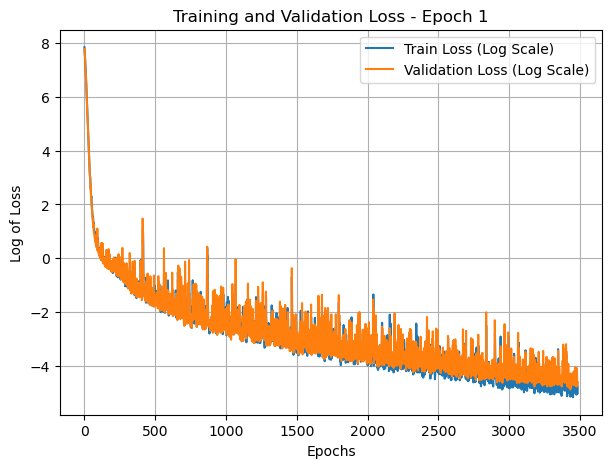

Epochs: 100%|██████████| 1/1 [00:01<00:00,  1.95s/it, train_loss=0.0087, val_loss=0.0101]


In [28]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython.display import clear_output

num_samples_x = 200

def live_plot(loss_train, loss_val, figsize=(7,5), title=''):
    clear_output(wait=True)
    plt.figure(figsize=figsize)
    # Apply logarithmic scale transformation to the loss values
    log_loss_train = np.log(loss_train)
    log_loss_val = np.log(loss_val)
    plt.plot(log_loss_train, label='Train Loss (Log Scale)')
    plt.plot(log_loss_val, label='Validation Loss (Log Scale)')
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Log of Loss')
    plt.legend()
    plt.grid(True)
    plt.show()


num_epochs = 2000  # Define number of epochs
epoch_pbar = tqdm(range(num_epochs), desc="Epochs")

for epoch in epoch_pbar:
    model.train()
    train_loss = 0.0
    num_batches = 0

    for P_batch, pos_batch, U_in_batch, U_out_batch in train_loader:
        P_batch, pos_batch, U_in_batch, U_out_batch = (
            P_batch.to(device), pos_batch.to(device), U_in_batch.to(device), U_out_batch.to(device)
        )

        random_indices = torch.randperm(U_in_batch.shape[1])[:num_samples_x]
        # print(U_in_batch.shape, pos_batch.shape, P_batch.shape)
        outputs = model(U_in_batch[:, random_indices, :, :], pos_batch[:, random_indices, :], P_batch)
        loss = criterion(outputs, U_out_batch[:, random_indices, :, :])
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_loss += loss.item()
        num_batches += 1

    train_avg_loss = train_loss / num_batches
    train_losses.append(train_avg_loss)

    model.eval()
    val_loss = 0.0
    val_batches = 0
    with torch.no_grad():
        for P_batch, pos_batch, U_in_batch, U_out_batch in valid_loader:
            P_batch, pos_batch, U_in_batch, U_out_batch = (
                P_batch.to(device), pos_batch.to(device), U_in_batch.to(device), U_out_batch.to(device)
            )

            outputs = model(U_in_batch[:, random_indices, :, :], pos_batch[:, random_indices, :], P_batch)
            loss = criterion(outputs, U_out_batch[:, random_indices, :, :])


            val_loss += loss.item()
            val_batches += 1
    
    scheduler.step()

    val_avg_loss = val_loss / val_batches if val_batches > 0 else 0
    val_losses.append(val_avg_loss)

    # Update plot after each epoch
    live_plot(train_losses, val_losses, title=f'Training and Validation Loss - Epoch {epoch+1}')
    epoch_pbar.set_postfix(train_loss=f"{train_avg_loss:.4f}", val_loss=f"{val_avg_loss:.4f}")

epoch_pbar.close()

In [29]:
torch.save({
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'loss': loss,
}, 'saved_model2.pth')

In [ ]:
checkpoint = torch.load('saved_model.pth', weights_only=False)

In [ ]:
model.load_state_dict(checkpoint['model_state_dict'])

In [30]:
model.eval()
P_batch_list, pos_batch_list, U_in_batch_list, U_out_batch_list, predictions_list  = [], [], [], [], []
# Fetch one sample from the test_loader
for P_batch, pos_batch, U_in_batch, U_out_batch in test_loader:
    P_batch, pos_batch, U_in_batch, U_out_batch = (
        P_batch.to(device), 
        pos_batch.to(device), 
        U_in_batch.to(device), 
        U_out_batch.to(device)
    )

    # Generate predictions (no gradients needed during evaluation)
    with torch.no_grad():
        predictions = model(U_in_batch, pos_batch, P_batch)

    P_batch_list.append(P_batch)
    pos_batch_list.append(pos_batch)
    U_in_batch_list.append(U_in_batch)
    U_out_batch_list.append(U_out_batch)
    predictions_list.append(predictions)

P_batch = torch.cat(P_batch_list, dim=0)
pos_batch = torch.cat(pos_batch_list, dim=0)
U_in_batch = torch.cat(U_in_batch_list, dim=0)  
U_out_batch = torch.cat(U_out_batch_list, dim=0)
predictions = torch.cat(predictions_list, dim=0)


In [31]:
import torch

def calculate_metrics(predictions, targets):
    """Calculate RMSE, R², L2, relative L2, max L1, MAE, MSLE, MAPE, and L infinity errors"""
    predictions = predictions.float()
    targets = targets.float()

    # Basic error metrics
    rmse = torch.sqrt(torch.mean((predictions - targets) ** 2))
    mae = torch.mean(torch.abs(predictions - targets))
    
    # L-infinity norm (maximum absolute error)
    l_infinity = torch.max(torch.abs(predictions - targets))

    # Calculating R² (Coefficient of Determination)
    target_mean = torch.mean(targets)
    ss_tot = torch.sum((targets - target_mean) ** 2)
    ss_res = torch.sum((targets - predictions) ** 2)
    r2 = 1 - ss_res / ss_tot

    # Norm-based metrics
    l2 = torch.norm(predictions - targets, p=2)
    rel_l2 = l2 / torch.norm(targets, p=2)
    max_l1 = torch.max(torch.abs(predictions - targets))

    # Logarithmic and percentage errors
    eps = 1e-6  # epsilon to avoid log(0)
    msle = torch.mean((torch.log(predictions + eps) - torch.log(targets + eps)) ** 2)
    mape = torch.mean(torch.abs((targets - predictions) / (targets + eps))) * 100

    return {
        "RMSE": rmse.item(),
        "R2": r2.item(),
        "L2 Norm": l2.item(),
        "Relative L2 Norm": rel_l2.item(),
        "Max L1 Error": max_l1.item(),
        "MAE": mae.item(),
        "MSLE": msle.item(),
        "MAPE": mape.item(),
        "L-infinity Norm": l_infinity.item()
    }

metrics = calculate_metrics(predictions, U_out_batch)

# Printing the metrics
for metric, value in metrics.items():
    print(f"{metric}: {value:.5f}")


RMSE: 0.09578
R2: 0.99994
L2 Norm: 248.84451
Relative L2 Norm: 0.00182
Max L1 Error: 1.12698
MAE: 0.07281
MSLE: 0.00000
MAPE: 0.15244
L-infinity Norm: 1.12698


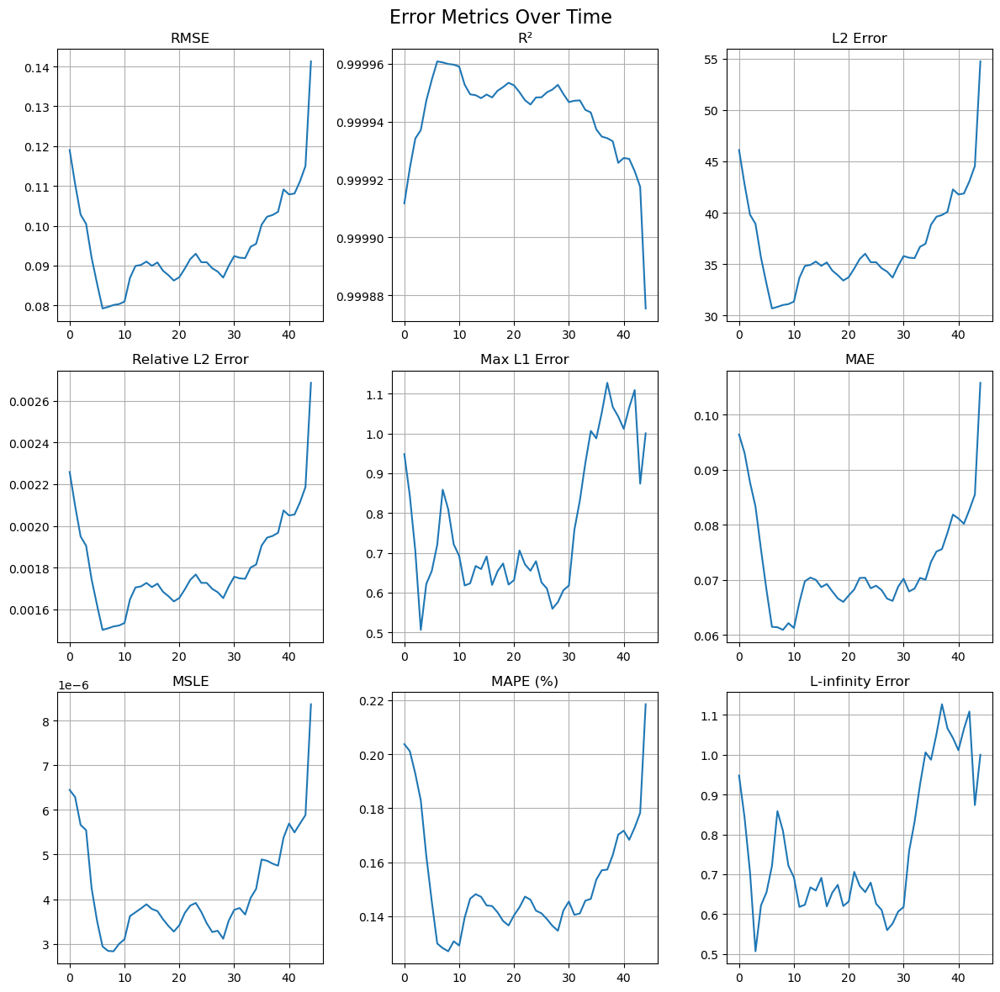

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import torch

def plot_error_metrics_over_time(pred, target):
    """
    Plot various error metrics over time for predicted and target tensors.
    
    Args:
        pred: Tensor of shape [nbatch, n_point, n_time, 1]
        target: Tensor of shape [nbatch, n_point, n_time, 1]
    """
    # Convert tensors to numpy if they're not already
    if isinstance(pred, torch.Tensor):
        pred = pred.cpu().numpy()
    if isinstance(target, torch.Tensor):
        target = target.cpu().numpy()
    
    n_time = pred.shape[2]
    
    # Initialize arrays to store metrics
    rmse = np.zeros(n_time)
    r2 = np.zeros(n_time)
    l2 = np.zeros(n_time)
    rel_l2 = np.zeros(n_time)
    max_l1 = np.zeros(n_time)
    mae = np.zeros(n_time)
    msle = np.zeros(n_time)
    mape = np.zeros(n_time)
    l_inf = np.zeros(n_time)
    
    # Calculate metrics for each time step
    for t in range(n_time):
        # Flatten predictions and target for current time step
        pred_t = pred[:, :, t, 0].flatten()
        target_t = target[:, :, t, 0].flatten()
        
        # RMSE
        rmse[t] = np.sqrt(mean_squared_error(target_t, pred_t))
        
        # R²
        r2[t] = r2_score(target_t, pred_t)
        
        # L2 norm
        l2[t] = np.linalg.norm(pred_t - target_t)
        
        # Relative L2
        rel_l2[t] = np.linalg.norm(pred_t - target_t) / np.linalg.norm(target_t)
        
        # Max L1
        max_l1[t] = np.max(np.abs(pred_t - target_t))
        
        # MAE
        mae[t] = mean_absolute_error(target_t, pred_t)
        
        # MSLE (adding small constant to avoid log(0))
        epsilon = 1e-10
        msle[t] = np.mean(np.square(np.log1p(pred_t + epsilon) - np.log1p(target_t + epsilon)))
        
        # MAPE
        mape[t] = np.mean(np.abs((target_t - pred_t) / (target_t + epsilon))) * 100
        
        # L-infinity norm
        l_inf[t] = np.max(np.abs(pred_t - target_t))
    
    # Create the plot
    fig, axs = plt.subplots(3, 3, figsize=(12, 12))
    fig.suptitle('Error Metrics Over Time', fontsize=16)
    
    # Plot each metric
    time_steps = np.arange(n_time)
    
    axs[0, 0].plot(time_steps, rmse)
    axs[0, 0].set_title('RMSE')
    axs[0, 0].grid(True)
    
    axs[0, 1].plot(time_steps, r2)
    axs[0, 1].set_title('R²')
    axs[0, 1].grid(True)
    
    axs[0, 2].plot(time_steps, l2)
    axs[0, 2].set_title('L2 Error')
    axs[0, 2].grid(True)
    
    axs[1, 0].plot(time_steps, rel_l2)
    axs[1, 0].set_title('Relative L2 Error')
    axs[1, 0].grid(True)
    
    axs[1, 1].plot(time_steps, max_l1)
    axs[1, 1].set_title('Max L1 Error')
    axs[1, 1].grid(True)
    
    axs[1, 2].plot(time_steps, mae)
    axs[1, 2].set_title('MAE')
    axs[1, 2].grid(True)
    
    axs[2, 0].plot(time_steps, msle)
    axs[2, 0].set_title('MSLE')
    axs[2, 0].grid(True)
    
    axs[2, 1].plot(time_steps, mape)
    axs[2, 1].set_title('MAPE (%)')
    axs[2, 1].grid(True)
    
    axs[2, 2].plot(time_steps, l_inf)
    axs[2, 2].set_title('L-infinity Error')
    axs[2, 2].grid(True)
    
    # Adjust layout and display
    plt.tight_layout()
    plt.show()
    
    # Return metrics dictionaries for further analysis if needed
    metrics = {
        'rmse': rmse,
        'r2': r2,
        'l2': l2,
        'relative_l2': rel_l2,
        'max_l1': max_l1,
        'mae': mae,
        'msle': msle,
        'mape': mape,
        'l_inf': l_inf
    }
    
    return metrics

# Example usage
metrics = plot_error_metrics_over_time(predictions, U_out_batch)

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
import torch
from IPython.display import HTML


# Select the first sample's predictions and true values
true_values = U_out_batch[15, :, :, 0].cpu().numpy()  # [n_point, T_out]
predicted_values = predictions[15, :, :, 0].cpu().numpy()  # [n_point, T_out]
x, y = pos_batch[0, :, 0].cpu().numpy(), pos_batch[0, :, 1].cpu().numpy()  # Spatial coordinates

# Create a figure for the animation with two subplots
fig = plt.figure(figsize=(14, 7))
ax_true = fig.add_subplot(121, projection='3d')
ax_pred = fig.add_subplot(122, projection='3d')

# Initialize scatter plots for true and predicted values
sc_true = ax_true.scatter(x, y, true_values[:, 0], color='blue', label='True Values', depthshade=False)
sc_pred = ax_pred.scatter(x, y, predicted_values[:, 0], color='red', label='Predictions', depthshade=False)

ax_true.set_title('True Values')
ax_pred.set_title('Predictions')
ax_true.set_xlabel('X Coordinate')
ax_true.set_ylabel('Y Coordinate')
ax_true.set_zlabel('Values')
ax_pred.set_xlabel('X Coordinate')
ax_pred.set_ylabel('Y Coordinate')
ax_pred.set_zlabel('Values')
ax_true.legend()
ax_pred.legend()

# Update function for animation
def update(frame):
    # Update data in scatter plots
    sc_true._offsets3d = (x, y, true_values[:, frame])
    sc_pred._offsets3d = (x, y, predicted_values[:, frame])
    return sc_true, sc_pred,

# Animate over the time steps
ani = FuncAnimation(fig, update, frames=np.arange(true_values.shape[1]), interval=200, repeat=True)

plt.close(fig)  # Close static plot display to avoid double display when showing animation
HTML(ani.to_jshtml())


In [45]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
import torch
from IPython.display import HTML

# Select the first sample's predictions and true values
true_values = U_out_batch[5, :, :, 0].cpu().numpy()  # [n_point, T_out]
predicted_values = predictions[5, :, :, 0].cpu().numpy()  # [n_point, T_out]
x, y = pos_batch[0, :, 0].cpu().numpy(), pos_batch[0, :, 1].cpu().numpy()  # Spatial coordinates

# Create a figure for the animation with two subplots
fig = plt.figure(figsize=(14, 7))
ax_true = fig.add_subplot(121, projection='3d')
ax_pred = fig.add_subplot(122, projection='3d')

# Initialize scatter plots for true and predicted values
sc_true = ax_true.scatter(x, y, true_values[:, 0], color='blue', label='True Values', depthshade=False)
sc_pred = ax_pred.scatter(x, y, predicted_values[:, 0], color='red', label='Predictions', depthshade=False)

# Set initial view angle
initial_elev = 20
initial_azim = 0
rotation_speed = 0.1  # Reduced rotation speed (will complete rotation in 4x the animation time)

ax_true.view_init(elev=initial_elev, azim=initial_azim)
ax_pred.view_init(elev=initial_elev, azim=initial_azim)

ax_true.set_title('True Values')
ax_pred.set_title('Predictions')
ax_true.set_xlabel('X Coordinate')
ax_true.set_ylabel('Y Coordinate')
ax_true.set_zlabel('Values')
ax_pred.set_xlabel('X Coordinate')
ax_pred.set_ylabel('Y Coordinate')
ax_pred.set_zlabel('Values')
ax_true.legend()
ax_pred.legend()

# Update function for animation
def update(frame):
    # Update data in scatter plots
    sc_true._offsets3d = (x, y, true_values[:, frame])
    sc_pred._offsets3d = (x, y, predicted_values[:, frame])
    
    # Update view angle - rotate more slowly
    new_angle = initial_azim + (frame * 360.0 * rotation_speed / true_values.shape[1])
    ax_true.view_init(elev=initial_elev, azim=new_angle)
    ax_pred.view_init(elev=initial_elev, azim=new_angle)
    
    return sc_true, sc_pred,

# Animate over the time steps
ani = FuncAnimation(fig, update, frames=np.arange(true_values.shape[1]), 
                   interval=200, repeat=True, blit=False)

plt.close(fig)  # Close static plot display to avoid double display when showing animation
HTML(ani.to_jshtml())

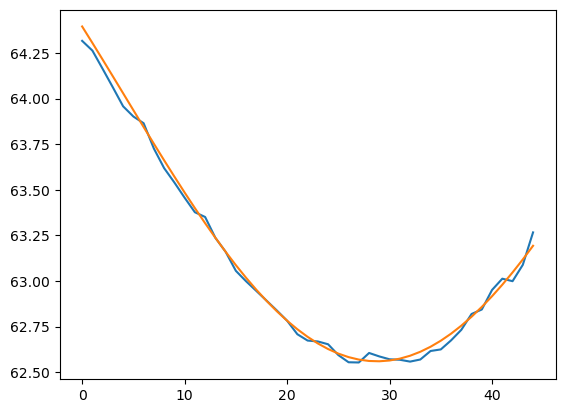

In [43]:
plt.plot(predictions[30, 28, :, 0].cpu().numpy())
plt.plot(U_out_batch[30, 28, :, 0].cpu().numpy())
